In [1]:
import sys
import xarray as xr
import numpy as np
import pandas as pd
import math
import glob
import yaml
import geopandas as gpd
import cartopy
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.colorbar import Colorbar # different way to handle colorbar
import matplotlib.ticker as mticker
import cmocean.cm as cmo

# cartopy
import cartopy.crs as ccrs
from cartopy.mpl.geoaxes import GeoAxes
import cartopy.feature as cfeature
import dask

# import personal modules
# Path to modules
sys.path.append('../modules')
# Import my modules
from utils import roundPartial, select_months_ds
from plotter import draw_basemap, plot_terrain, plot_arscale_cbar
from colorline import colorline
from trajectory_post_funcs import calculate_heatmaps_from_trajectories
import customcmaps as ccmap

dask.config.set(**{'array.slicing.split_large_chunks': True})

ERROR 1: PROJ: proj_create_from_database: Open of /home/dnash/miniconda3/envs/SEAK-impacts/share/proj failed


In [2]:
path_to_data = '/expanse/nfs/cw3e/cwp140/'
path_to_out  = '../out/'       # output files (numerical results, intermediate datafiles) -- read & write
path_to_figs = '../figs/'      # figures

In [3]:
## load watershed shapefile
## use geopandas to import the shapefile
fp = path_to_data + 'downloads/CO_HUC8/wbdhu8.shp'
polys = gpd.read_file(fp, crs="epsg:4326") # have to manually set the projection
## set a column to be the first two numbers 
## get first two numbers of HUC8
basin_number = polys['HUC8'].values
newlist = [x[:2] for x in basin_number]
polys['basin'] = newlist
tmp = polys.dissolve(by='basin', aggfunc='sum')
tmp['basin'] = [10, 11, 13, 14]
tmp

,geometry,OBJECTID,TNMID,MetaSource,SourceData,SourceOrig,SourceFeat,LoadDate,GNIS_ID,AreaAcres,AreaSqKm,States,HUC8,Name,Shape_Leng,Shape_Area,basin
basin,,,,,,,,,,,,,,,,,
10,"POLYGON ((-105.86763 39.49419, -105.86738 39.4...",1459,{88F45F9F-080F-45EF-9653-CC111BD4D053}{E180B15...,0,0,0,0,2012-06-112012-06-112012-06-112012-06-112012-0...,0,29440289.37,119140.77,"COCOCOCO,KS,NECO,NECO,NECOCO,NE,WYCO,NECO,WYCO...",1019001110190013101900141025000110250005101900...,BijouBeaverPawneeArikareeFrenchmanLower South ...,146.538055,12.613489,10
11,"POLYGON ((-103.03204 36.72690, -103.03261 36.7...",984,{FD7D8C74-67B1-4679-A903-413DB9337C81}{2BD36A3...,0,0,0,0,2016-10-112012-06-112012-06-112012-06-112012-0...,0,23931227.67,96846.34,"COCOCO,NMCOCOCO,KS,NM,OKCOCO,NM,OKCOCO,NMCO,KS...",1102000211020006110800011102000811020012110400...,Upper ArkansasHuerfanoCanadian HeadwatersHorse...,102.935513,9.929023,11
13,"POLYGON ((-105.23421 37.03533, -105.23449 37.0...",343,{3C828B69-1041-4E06-98D9-546F1A0AB778}{72C226B...,0,0,0,0,2012-06-112012-06-112017-09-202012-06-112017-0...,0,8975607.30,36323.02,"CO,NMCO,NMCO,NMCOCO,NMCOCO",1301000513020102130100021301000413020101130100...,ConejosRio ChamaAlamosa-TrincheraSaguacheUpper...,33.428383,3.681679,13
14,"POLYGON ((-108.25677 36.48243, -108.25707 36.4...",1492,{75740F8C-AFFA-40B5-908E-4911BCB38D0B}{9CE10C9...,0,0,0,0,2012-06-112012-06-112012-06-112012-06-112012-0...,0,35639918.22,144229.79,"CO,NMAZ,CO,NMCOCOCOCO,WYCO,UTCOCO,UTCO,UTCO,WY...",1408010714080105140200051402000214050002140401...,MancosMiddle San JuanLower GunnisonUpper Gunni...,144.552341,15.010810,14


In [4]:
HUC8_ID_lst = ['14020001']
HUC8_lbl_lst = ['East-Taylor']
subbasin = ['East-Taylor']
traj_path = '/expanse/nfs/cw3e/cwp140/preprocessed/ERA5_trajectories/combined_all/'
ds_lst = []
for i, HUC8_ID in enumerate(HUC8_ID_lst):
    fname = traj_path + 'PRISM_HUC8_{0}.nc'.format(HUC8_ID)
    ds = xr.open_dataset(fname)
    ds['ar_scale'] = ds.ar_scale.fillna(0)
    ds_lst.append(ds)
    ndays_ar = len(ds.where(ds.ar_scale > 0, drop=True).start_date)
    ndays = len(ds.start_date)
    print(ndays, ndays_ar)

ds_lst[0]

2116 713


<xarray.Dataset>
Dimensions:             (index: 72, start_date: 2116)
Coordinates:
  * index               (index) int64 0 1 2 3 4 5 6 7 ... 65 66 67 68 69 70 71
    time                (start_date, index) datetime64[ns] ...
  * start_date          (start_date) datetime64[ns] 2000-01-05 ... 2023-12-24
    lon                 (start_date, index) float64 ...
    lat                 (start_date, index) float64 ...
Data variables: (12/18)
    level               (start_date, index) float64 ...
    q                   (start_date, index) float64 ...
    u                   (start_date, index) float64 ...
    v                   (start_date, index) float64 ...
    w                   (start_date, index) float64 ...
    IVT                 (start_date, index) float64 ...
    ...                  ...
    tARget_strict       (start_date) float64 ...
    coastal_IVT_strict  (start_date) float64 ...
    ar_scale            (start_date) float64 3.0 2.0 2.0 2.0 ... 3.0 0.0 0.0 2.0
    coastal_IVT         (start_date) float64 ...
    ar                  (start_date) float64 ...
    tARget              (start_date) float64 ...

In [5]:
## compute heatmaps
cell_lst = []
cell_lst2 = []

for i, ds in enumerate(ds_lst):
    print('Selecting AR days only')
    AR = ds.load().where(ds.ar_scale > 0, drop=True)
    tmp = ds.load().where((ds.ar_scale == 0), drop=True)
    
    ## now calculate heatmaps from remaining trajectories
    print('computing frequency for ARs')
    cell = calculate_heatmaps_from_trajectories(AR, normalize=False)
    print('computing frequency for non ARs')
    cell2 = calculate_heatmaps_from_trajectories(tmp, normalize=False)
    
    # AR = ds.where(ds.ar_scale > 0, drop=True)
    # cell = calculate_heatmaps_from_trajectories(HUC8_ID)
    cell_lst.append(cell)
    cell_lst2.append(cell2)

Selecting AR days only
computing frequency for ARs
computing frequency for non ARs


In [6]:
fp = path_to_data + 'downloads/CO_HUC8/wbdhu8.shp'
polys = gpd.read_file(fp, crs="epsg:4326") # have to manually set the projection

polys_lst = []
for i, HUC8_ID in enumerate(HUC8_ID_lst):
    idx = (polys.HUC8 == HUC8_ID)
    polys_lst.append(polys[idx])
polys_lst

[    OBJECTID                                   TNMID MetaSource SourceData  \
 65        66  {9AEDE168-54E8-42B2-A580-F7EC70997690}       None       None   
 
    SourceOrig SourceFeat    LoadDate  GNIS_ID  AreaAcres  AreaSqKm States  \
 65       None       None  2012-06-11        0  490805.55   1986.22     CO   
 
         HUC8         Name  Shape_Leng  Shape_Area  \
 65  14020001  East-Taylor    2.617179    0.206094   
 
                                              geometry  
 65  POLYGON ((-106.70218 39.05557, -106.70201 39.0...  ]

In [7]:
# # select WY
# NDJFMA = select_months_ds(final_ds, 11, 4)
# MJJASO = select_months_ds(final_ds, 5, 10)
# ds_lst = [NDJFMA, MJJASO]

# ## Select Season
# DJF = final_ds.sel(start_date=final_ds.start_date.dt.season=="DJF")
# MAM = final_ds.sel(start_date=final_ds.start_date.dt.season=="MAM")
# JJA = final_ds.sel(start_date=final_ds.start_date.dt.season=="JJA")
# SON = final_ds.sel(start_date=final_ds.start_date.dt.season=="SON")
# ds_lst = [DJF, MAM, JJA, SON]


In [8]:
# min_ivt = ds.IVT.min().values
# max_ivt = ds.IVT.max().values
# print(np.round(min_ivt), np.round(max_ivt))

# min_q = final_ds.q.min().values
# max_q = final_ds.q.max().values
# print(np.round(min_q), np.round(max_q))

In [9]:
# Set up projection
datacrs = ccrs.PlateCarree()  ## the projection the data is in
mapcrs = ccrs.PlateCarree() ## the projection you want your map displayed in
ext = [-130., -85., 25., 60.]
# Set tick/grid locations
tx = 10
ty = 5
dx = np.arange(ext[0],ext[1]+tx,tx)
dy = np.arange(ext[2],ext[3]+ty,ty)

In [10]:
ds

<xarray.Dataset>
Dimensions:             (index: 72, start_date: 2116)
Coordinates:
  * index               (index) int64 0 1 2 3 4 5 6 7 ... 65 66 67 68 69 70 71
    time                (start_date, index) datetime64[ns] 2000-01-05 ... 202...
  * start_date          (start_date) datetime64[ns] 2000-01-05 ... 2023-12-24
    lon                 (start_date, index) float64 -106.7 -107.2 ... -112.2
    lat                 (start_date, index) float64 38.85 38.95 ... 28.76 28.69
Data variables: (12/18)
    level               (start_date, index) float64 600.0 608.4 ... 957.7 952.9
    q                   (start_date, index) float64 2.066 2.066 ... 7.362 7.374
    u                   (start_date, index) float64 14.72 12.22 ... 0.7506
    v                   (start_date, index) float64 -3.272 -2.613 ... 1.259
    w                   (start_date, index) float64 -0.2334 0.03079 ... 0.1842
    IVT                 (start_date, index) float64 53.67 53.44 ... 125.0 138.2
    ...                  ...
    tARget_strict       (start_date) float64 nan nan nan nan ... nan nan nan nan
    coastal_IVT_strict  (start_date) float64 278.8 196.1 255.8 ... nan 57.8 77.0
    ar_scale            (start_date) float64 3.0 2.0 2.0 2.0 ... 3.0 0.0 0.0 2.0
    coastal_IVT         (start_date) float64 734.9 346.0 456.6 ... 120.5 316.4
    ar                  (start_date) float64 1.0 1.0 1.0 1.0 ... 1.0 nan 0.0 0.0
    tARget              (start_date) float64 2e+11 nan nan 2e+11 ... nan nan nan

/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords,

j 1 0
j 2 469


/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords,

j 3 185


/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords, out=out, **kwargs)
/home/dnash/miniconda3/envs/SEAK-impacts/lib/python3.12/site-packages/shapely/creation.py:119: RuntimeWarning: invalid value encountered in linestrings
  return lib.linestrings(coords,

j 4 48
j 5 8


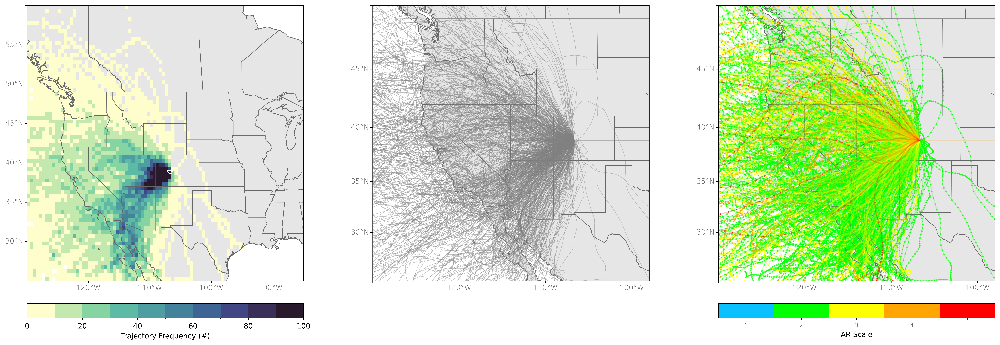

In [11]:
nrows = 2
ncols = 3

## Use gridspec to set up a plot with a series of subplots that is
## n-rows by n-columns
gs = GridSpec(nrows, ncols, height_ratios=[1, 0.05], width_ratios = [1, 1, 1], wspace=0.25, hspace=0.1)
## use gs[rows index, columns index] to access grids

fig = plt.figure(figsize=(24.0, 8.0))
fig.dpi = 600
fname = path_to_figs + 'ARScale_trajectory_heatmaps_yesAR_{0}'.format(subbasin[0])
fmt = 'png'
#####################
### PLOT HEATMAPS ###
#####################
# Set up projection
datacrs = ccrs.PlateCarree()  ## the projection the data is in
mapcrs = ccrs.PlateCarree() ## the projection you want your map displayed in
ext = [-130., -85., 25., 60.] 
# Add color bar axis
cbax = plt.subplot(gs[1,0]) # colorbar axis

row_idx = [0]
col_idx = [0]
llat_lst = [True]
for i, cell in enumerate(cell_lst):
    ax = fig.add_subplot(gs[row_idx[i],col_idx[i]], projection=mapcrs)
    ax = draw_basemap(ax, extent=ext, xticks=dx, yticks=dy,left_lats=llat_lst[i], right_lats=False)
    

    ax.add_feature(cfeature.STATES, edgecolor='0.4', linewidth=0.8)
    cmap, norm, bnds = ccmap.cmap_segmented(cmo.deep, np.arange(0, 110, 10))

    ## plotting based off of https://geopandas.org/en/stable/docs/user_guide/mapping.html
    cf = cell.plot(ax=ax, column='n_traj', cmap=cmo.deep, vmin=bnds[0], vmax=bnds[-1], norm=norm, edgecolor=None, legend=True, cax=cbax,
                  legend_kwds={"label": "Trajectory Frequency (#)", "orientation": "horizontal"})

    ## add in four focus watersheds
    polys_lst[i].plot(ax=ax, edgecolor='white', color='None', zorder=99)

    ax.set_extent(ext, datacrs)

####################################
### PLOT TRAJECTORIES - NO COLOR ###
####################################
mapcrs = ccrs.Mercator()
ext = [-130., -98., 25., 50.] 

ax = fig.add_subplot(gs[0, 1], projection=mapcrs)
# ax.set_title(HUC8_lbls[k], loc='left', fontsize=14)
ax = draw_basemap(ax, extent=ext, xticks=dx, yticks=dy, left_lats=True, right_lats=False)
ax.set_extent(ext, datacrs)
ax.add_feature(cfeature.STATES, edgecolor='0.4', linewidth=0.8)
AR = ds.where(ds.ar_scale > 0, drop=True)
# need this to fix annotate transform
# transform = datacrs._as_mpl_transform(ax)
nevents = len(AR.start_date)
## Add different points
for i in range(nevents):
    data = AR.isel(start_date=i)
    y_lst = data.lat.values
    x_lst = data.lon.values
    z_lst = data.IVT.values
    ax.plot(x_lst, y_lst, c='gray', transform=datacrs, alpha=0.5, linewidth=0.5)
    cmap, norm, bnds = ccmap.cmap('ivt')
    # cf = ax.scatter(x_lst, y_lst, c=z_lst, cmap=cmap, norm=norm, marker='.', transform=datacrs, alpha=0.8, s=6)


############################
### PLOT AR SCALE VALUES ###
############################
mapcrs = ccrs.Mercator()
ext = [-130., -98., 25., 50.] 
colors = ['#0ac1ff', '#04ff03', '#ffff03', '#ffa602', '#ff0100']

ax = fig.add_subplot(gs[0, 2], projection=mapcrs)
# ax.set_title(HUC8_lbls[k], loc='left', fontsize=14)
ax = draw_basemap(ax, extent=ext, xticks=dx, yticks=dy, left_lats=True, right_lats=False)
ax.set_extent(ext, datacrs)
ax.add_feature(cfeature.STATES, edgecolor='0.4', linewidth=0.8)

## INNER LOOP - Loop through AR scale values
for j in range(1, 6):
    try:
        AR = ds.where(ds.ar_scale == j, drop=True)
        nevents = len(AR.start_date)
        print('j', j, nevents)
        ## LOOP THROUGH TRAJECTORIES
        for i in range(nevents):
            data = AR.isel(start_date=i)
            y_lst = data.lat.values
            x_lst = data.lon.values
            ax.plot(x_lst, y_lst, c=colors[j-1], transform=datacrs, alpha=0.2)
            cf = ax.scatter(x_lst, y_lst, c=colors[j-1], marker='.', transform=datacrs, alpha=0.7, s=6)
    except IndexError:
        pass

# # Add color bar
cbax = plt.subplot(gs[-1,-1]) # colorbar axis
plot_arscale_cbar(cbax, orientation='horizontal')

fig.savefig('%s.%s' %(fname, fmt), bbox_inches='tight', dpi=fig.dpi, transparent=True)
plt.show()
fig.clf()